# Global COVID-19 Data
__[owid covid-19 dataset](https://github.com/owid/covid-19-data/tree/master/public/data)__

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

sns.set_theme()
%matplotlib inline

In [2]:
source = "https://covid.ourworldindata.org/data/owid-covid-data.csv"
# source = "owid-covid-data.csv"
data = pd.read_csv(source, index_col=3, parse_dates=True)

In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 163090 entries, 2020-02-24 to 2022-02-19
Data columns (total 66 columns):
 #   Column                                      Non-Null Count   Dtype  
---  ------                                      --------------   -----  
 0   iso_code                                    163090 non-null  object 
 1   continent                                   153316 non-null  object 
 2   location                                    163090 non-null  object 
 3   total_cases                                 160098 non-null  float64
 4   new_cases                                   160034 non-null  float64
 5   new_cases_smoothed                          158883 non-null  float64
 6   total_deaths                                142384 non-null  float64
 7   new_deaths                                  142549 non-null  float64
 8   new_deaths_smoothed                         142419 non-null  float64
 9   total_cases_per_million                     159354 non

In [4]:
df = data[["location", "continent", "total_deaths", "total_cases"]]

In [5]:
df.insert(2, "cummulative_death_rate", (df["total_deaths"] / df["total_cases"])*100)

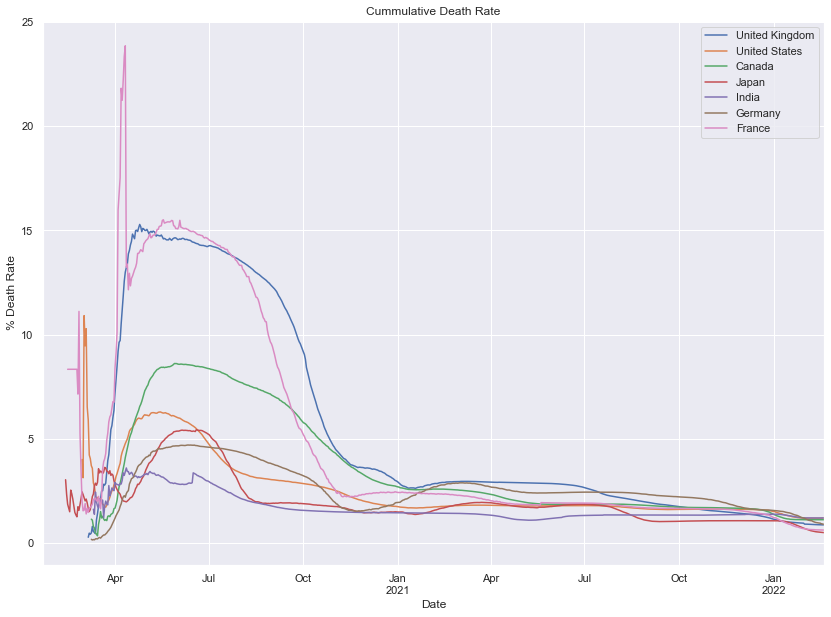

In [6]:
countries = ["United Kingdom", "United States", "Canada", "Japan", "India", "Germany", "France"]
for country in countries:
    df[df["location"] == country]["cummulative_death_rate"].plot(figsize=(14,10), label=country)
plt.xlabel("Date"), plt.ylabel("% Death Rate"), plt.title("Cummulative Death Rate")
plt.legend()

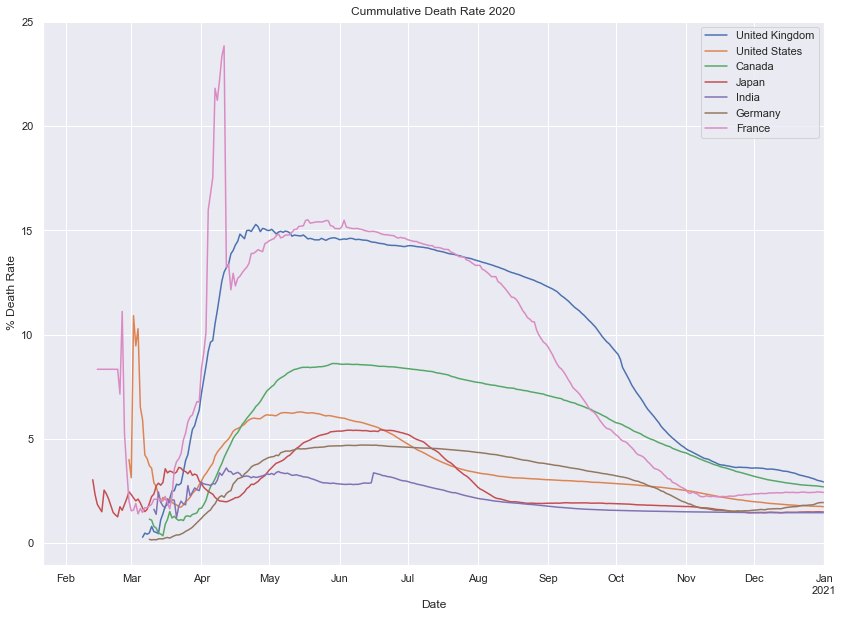

In [7]:
countries = ["United Kingdom", "United States", "Canada", "Japan", "India", "Germany", "France"]
for country in countries:
    df[df["location"] == country]["cummulative_death_rate"].loc["2020-01-01": "2021-01-01"].plot(figsize=(14,10), label=country)
plt.xlabel("Date"), plt.ylabel("% Death Rate"), plt.title("Cummulative Death Rate 2020")
plt.legend()

### Spread of Covid

In [8]:
df = data.dropna(subset=["continent"])
df = df[["location", "continent", "population", "total_cases", "total_cases_per_million"]].sort_index()

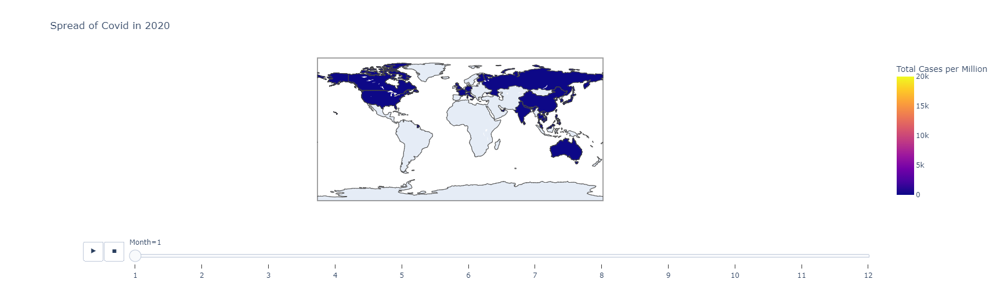

In [9]:
df2020 = df.loc[:"2020-12-31"]
df2020.insert(0, "month", df2020.index.month)
df2020 = df2020.sort_values("month")
fig = px.choropleth(data_frame = df2020,
                    locations = "location",
                    locationmode = "country names",
                    color = "total_cases_per_million",
                    hover_name = "location",
                    hover_data = ["location", "continent", "population", "total_cases"],
                    labels = {"total_cases_per_million": "Total Cases per Million",
                              "total_cases": "Total Cases",
                              "month": "Month",
                              "location": "Country",
                              "continent": "Continent", 
                              "population": "Population"},
                    animation_frame = df2020["month"],
                    range_color = (0, 2*10**4),
                    title = "Spread of Covid in 2020",
                    template = "plotly",
                    width = 700,
                    height = 500)
fig.show()

<AxesSubplot:xlabel='date'>

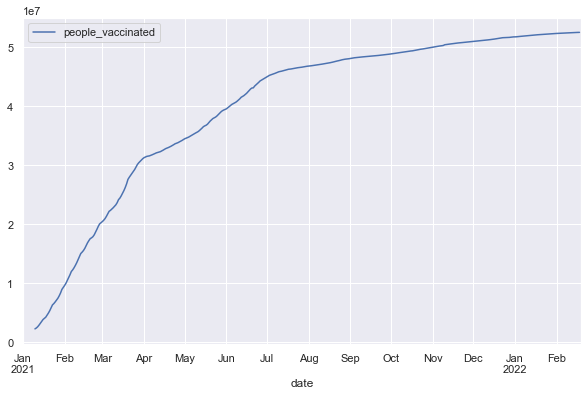

In [13]:
df = data[["location", "continent", "people_vaccinated"]]
df[df["location"] == "United Kingdom"].loc["2021-01-01":].plot(figsize=(10,6))